# **Projet 6 :** Classifiez automatiquement des biens de consommation

## Notebook de prétraitement et exploration

### Import

In [1]:
import uuid
import json
import os

from tqdm.notebook import tqdm

import cv2

In [2]:
%pylab inline
import pandas as pd
from sklearn import preprocessing

Populating the interactive namespace from numpy and matplotlib


### Configuration

In [3]:
%load_ext autoreload
%autoreload 2

# configurations pandas
pd.set_option('display.max_rows', 250)
pd.set_option('display.max_columns', 250)

### Chargement des données

In [4]:
path = './data/Flipkart'
data = pd.read_csv(os.path.join(path,'flipkart_com-ecommerce_sample_1050.csv'))
print(data.shape)

data.drop([
    'crawl_timestamp', 'product_url', 'pid', 'retail_price', 'discounted_price', 'is_FK_Advantage_product', 'product_rating',
    'overall_rating','brand', 'product_category_1', 'product_category_2', 'product_category_3', 'product_category_4',
    'product_category_5', 'product_category_6'
], axis=1, inplace=True, errors='ignore')

def product_specification_decode(json_str):
    s = json_str.lower().replace("=>", ':').replace('{"product_specification":nil}', '{"product_specification":""}')
    return json.loads(s)

def product_category_tree_decode(json_str):
    cat_list = json.loads(json_str.lower())
    assert(isinstance(cat_list, list))
    assert(len(cat_list) == 1)
    return [s.strip() for s in cat_list[0].split('>>')]

data['uniq_id'] = data['uniq_id'].apply(lambda x: uuid.UUID(x))
data['product_category_tree'] = data['product_category_tree'].apply(product_category_tree_decode)
data[[f"product_category_{i}" for i in range(7)]] = pd.DataFrame(data['product_category_tree'].tolist(), index= data.index)
data['description'] = data['description'].apply(lambda x: x.lower())
data['product_name'] = data['product_name'].apply(lambda x: x.lower())
data['product_name_description'] = data['product_name'] + ' ' + data['description']
data.set_index('uniq_id', inplace=True, verify_integrity=True)

# Label encoding pour cat 0
le = preprocessing.LabelEncoder()
product_category_0 = data['product_category_0'].unique()
le.fit(product_category_0)
data['product_category_0_label'] = le.transform(data['product_category_0'])
data.head()

(1050, 15)


,product_name,product_category_tree,image,description,product_specifications,product_category_0,product_category_1,product_category_2,product_category_3,product_category_4,product_category_5,product_category_6,product_name_description,product_category_0_label
uniq_id,,,,,,,,,,,,,,
55b85ea1-5a15-36d4-6b71-90ad6fff8ce7,elegance polyester multicolor abstract eyelet ...,"[home furnishing, curtains & accessories, curt...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,key features of elegance polyester multicolor ...,"{""product_specification""=>[{""key""=>""Brand"", ""v...",home furnishing,curtains & accessories,curtains,elegance polyester multicolor abstract eyelet ...,None,None,None,elegance polyester multicolor abstract eyelet ...,4
7b72c92c-2f6c-4026-8628-ec5f14c6d590,sathiyas cotton bath towel,"[baby care, baby bath & skin, baby bath towels...",7b72c92c2f6c40268628ec5f14c6d590.jpg,specifications of sathiyas cotton bath towel (...,"{""product_specification""=>[{""key""=>""Machine Wa...",baby care,baby bath & skin,baby bath towels,sathiyas baby bath towels,"sathiyas cotton bath towel (3 bath towel, red,...",None,None,sathiyas cotton bath towel specifications of s...,0
64d5d4a2-5824-3731-dc7b-bb1eef49ad74,eurospa cotton terry face towel set,"[baby care, baby bath & skin, baby bath towels...",64d5d4a258243731dc7bbb1eef49ad74.jpg,key features of eurospa cotton terry face towe...,"{""product_specification""=>[{""key""=>""Material"",...",baby care,baby bath & skin,baby bath towels,eurospa baby bath towels,eurospa cotton terry face towel set (20 piece ...,None,None,eurospa cotton terry face towel set key featur...,0
d4684dcd-c759-dd9c-df41-504698d737d8,santosh royal fashion cotton printed king size...,"[home furnishing, bed linen, bedsheets, santos...",d4684dcdc759dd9cdf41504698d737d8.jpg,key features of santosh royal fashion cotton p...,"{""product_specification""=>[{""key""=>""Brand"", ""v...",home furnishing,bed linen,bedsheets,santosh royal fashion bedsheets,santosh royal fashion cotton printed king size...,None,None,santosh royal fashion cotton printed king size...,4
6325b687-0c54-cd47-be6e-bfbffa620ec7,jaipur print cotton floral king sized double b...,"[home furnishing, bed linen, bedsheets, jaipur...",6325b6870c54cd47be6ebfbffa620ec7.jpg,key features of jaipur print cotton floral kin...,"{""product_specification""=>[{""key""=>""Machine Wa...",home furnishing,bed linen,bedsheets,jaipur print bedsheets,jaipur print cotton floral king sized double b...,None,None,jaipur print cotton floral king sized double b...,4


In [5]:
sample_data = data
#sample_data = data.sample(25)

### Extraction des features image avec l'algorithme : SIFT

Alternatives :
- ORB
- SURF

descriptor shape: (1558, 128)


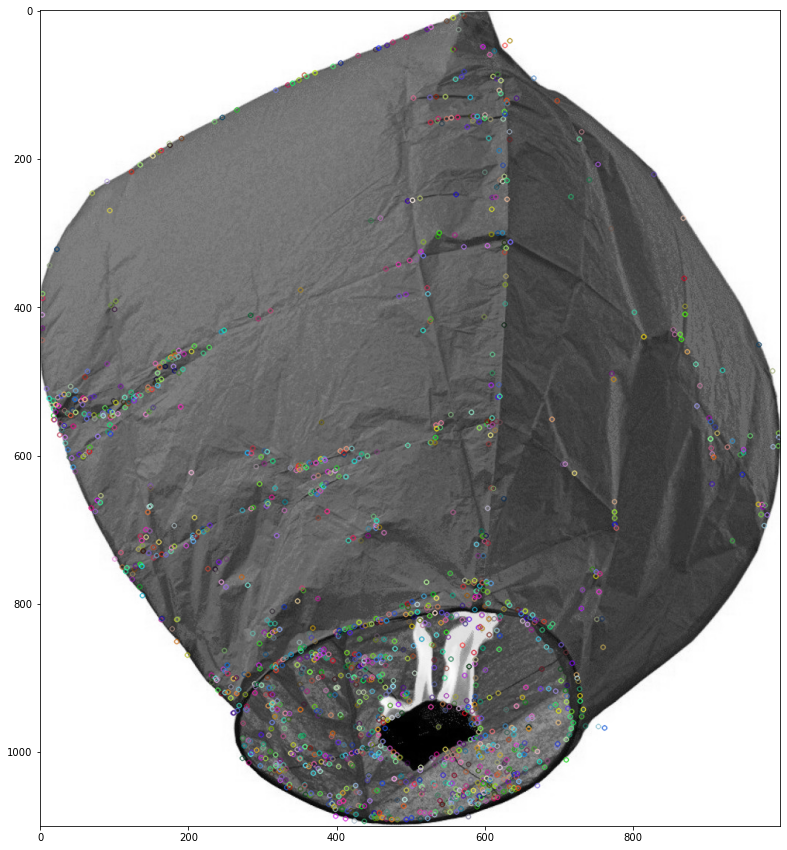

In [6]:
# TEST
# Loading the image
img = cv2.imread('./data/Flipkart/Images/0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg')

# Converting image to grayscale
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# Applying SIFT detector
sift = cv2.SIFT_create()
kp, desc = sift.detectAndCompute(gray, None)
print("descriptor shape:", desc.shape)

# Marking the keypoint on the image using circles
cv2.drawKeypoints(gray, kp, img)

plt.figure(figsize=(30,15))
plt.imshow(img)

### Test du traitement des images

l'image `9743e6d1c9f3180483825fe4d2e97836.jpg` n'a pas de keypoint et donc a besoin d'un traitement

In [7]:
# TEST
# no kp with this image
img = cv2.imread('./data/Flipkart/Images/9743e6d1c9f3180483825fe4d2e97836.jpg')

# Converting image to grayscale
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# Applying SIFT detector
sift = cv2.SIFT_create()
kp, desc = sift.detectAndCompute(gray, None)
print("sift keypoint:", len(kp))

sift keypoint: 0


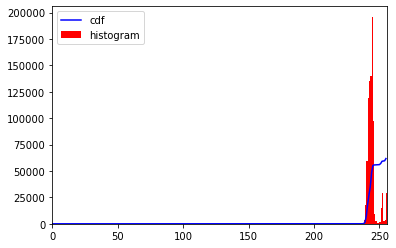

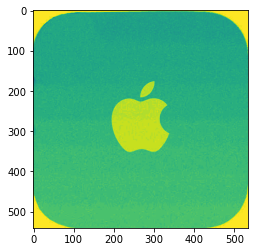

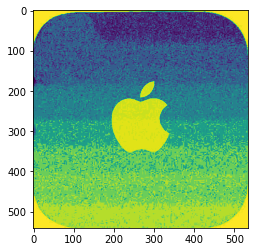

In [8]:
# histogram
hist, bins = np.histogram(gray.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()

plt.imshow(gray)
plt.show()

cdf_m = np.ma.masked_equal(cdf,0)
cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
cdf = np.ma.filled(cdf_m,0).astype('uint8')

gray2 = cdf[gray]

plt.imshow(gray2)
plt.show()

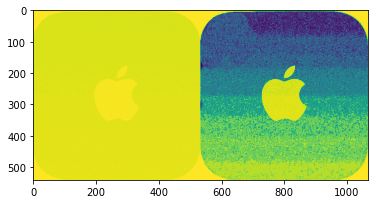

In [9]:
# TEST cv equalizeHist
equ = cv2.equalizeHist(gray)
res = np.hstack((gray, equ)) #stacking images side-by-side
plt.imshow(res)

sift keypoint: 1


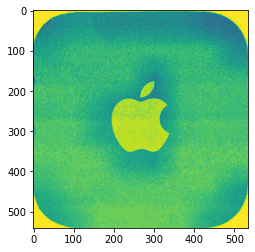

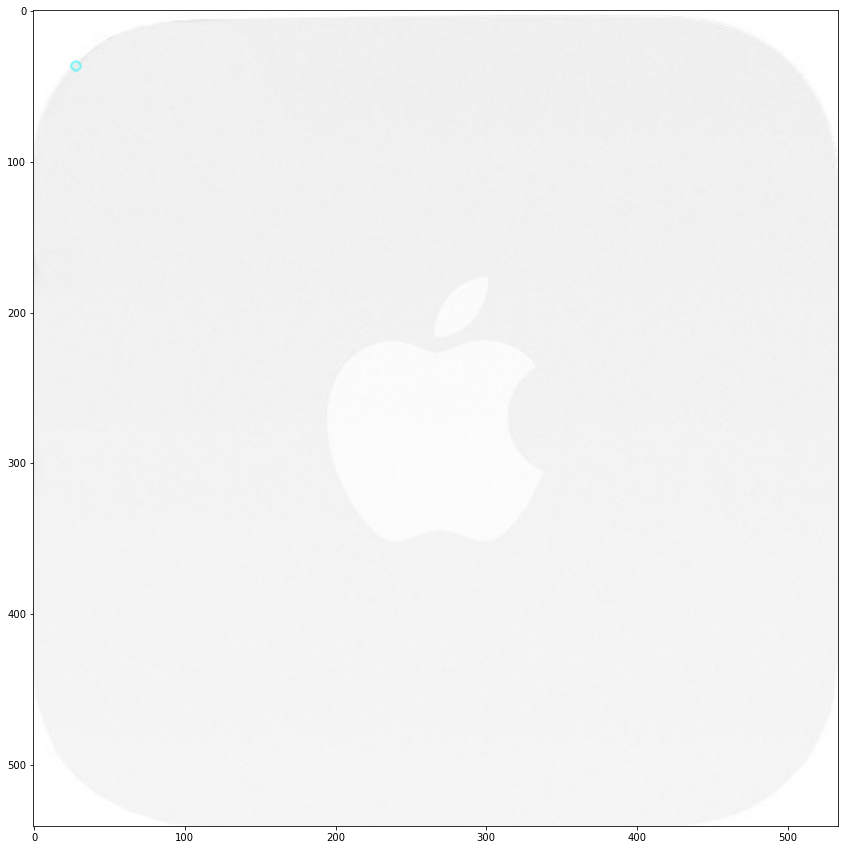

In [10]:
# create a CLAHE object (Arguments are optional).
# TODO filtre bruit
_img = img
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
cl1 = clahe.apply(gray)
plt.imshow(cl1)

# Applying SIFT detector
sift = cv2.SIFT_create()
kp, desc = sift.detectAndCompute(cl1, None)
print("sift keypoint:", len(kp))

# Marking the keypoint on the image using circles
cv2.drawKeypoints(gray, kp, _img)

plt.figure(figsize=(30,15))
plt.imshow(_img)

### Clustering des images avec SIFT

In [11]:
from src.opencv_app import SiftApp
app = SiftApp(sample_data['image'].to_dict(), sample_data['product_category_0'].to_dict())
app.create_embedding_matrix(with_filters=True)
app.create_kmean_model()
app.create_histogram()

Loading images...


  0%|          | 0/1050 [00:00<?, ?it/s]

number of images : 1050 , number of class : 7
Create sift wrapper...


  0%|          | 0/1050 [00:00<?, ?it/s]

Detecting keypoints...


  0%|          | 0/1050 [00:00<?, ?it/s]

Creating kmean model...
k = 70 , batch_size = 3150
Make histogram...


  0%|          | 0/1050 [00:00<?, ?it/s]

Computing ARI with TSNE(2d)...
ARI with TSNE(2): 0.0524
Plot clustering...


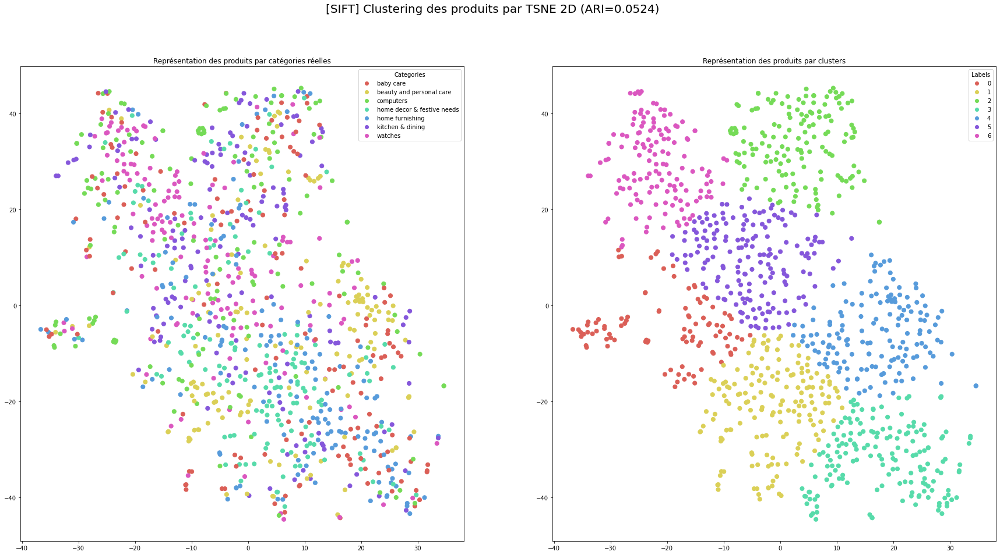

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

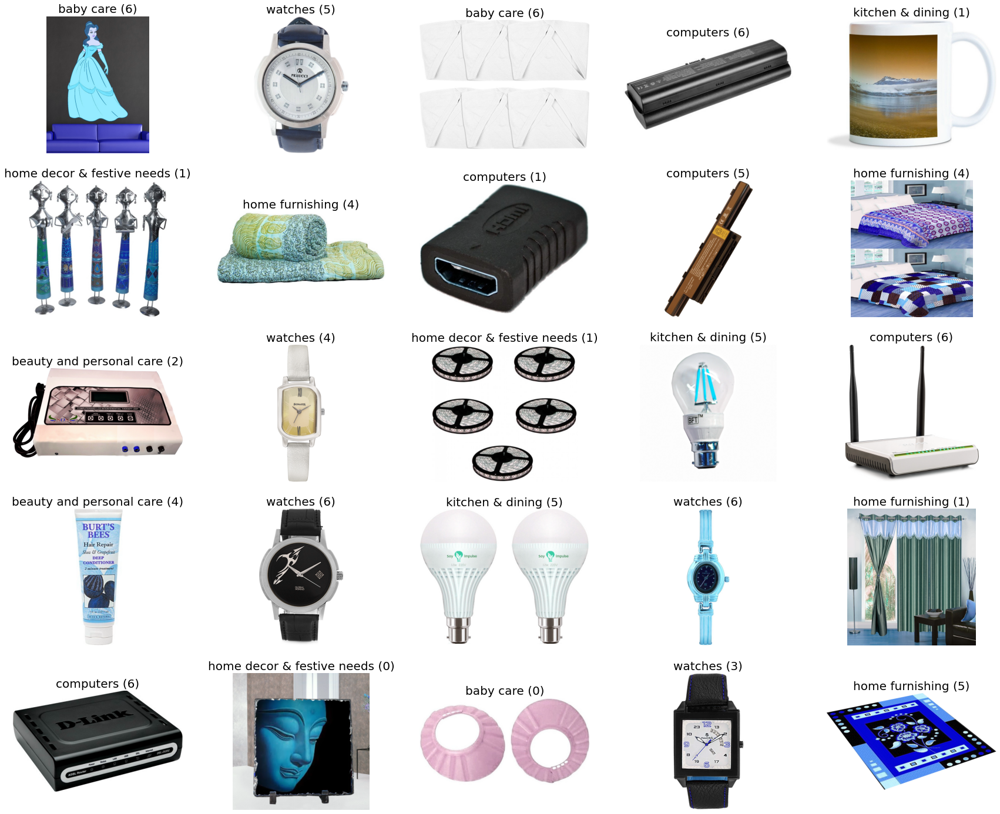

Computing ARI with TSNE(3d)...
ARI with TSNE(3): 0.0436
Plot clustering...


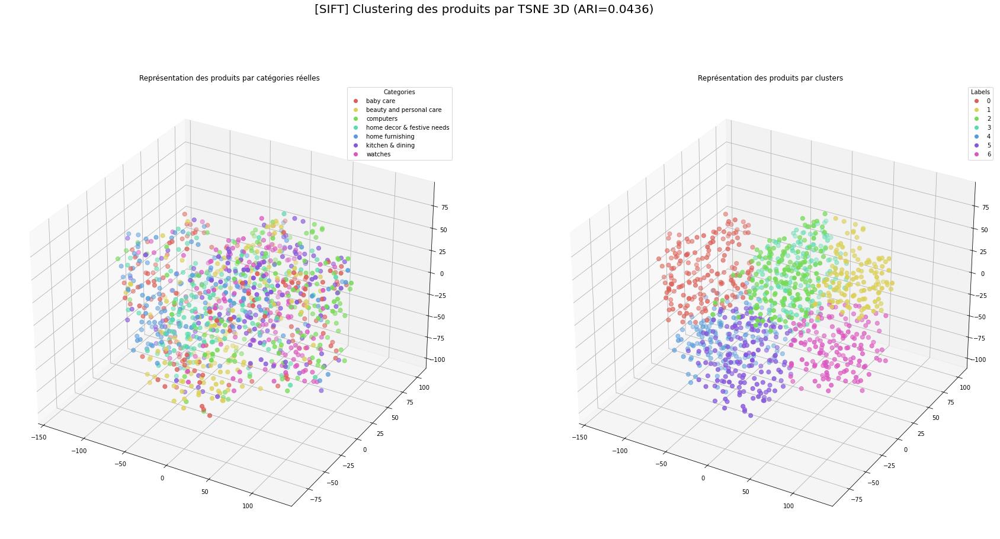

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

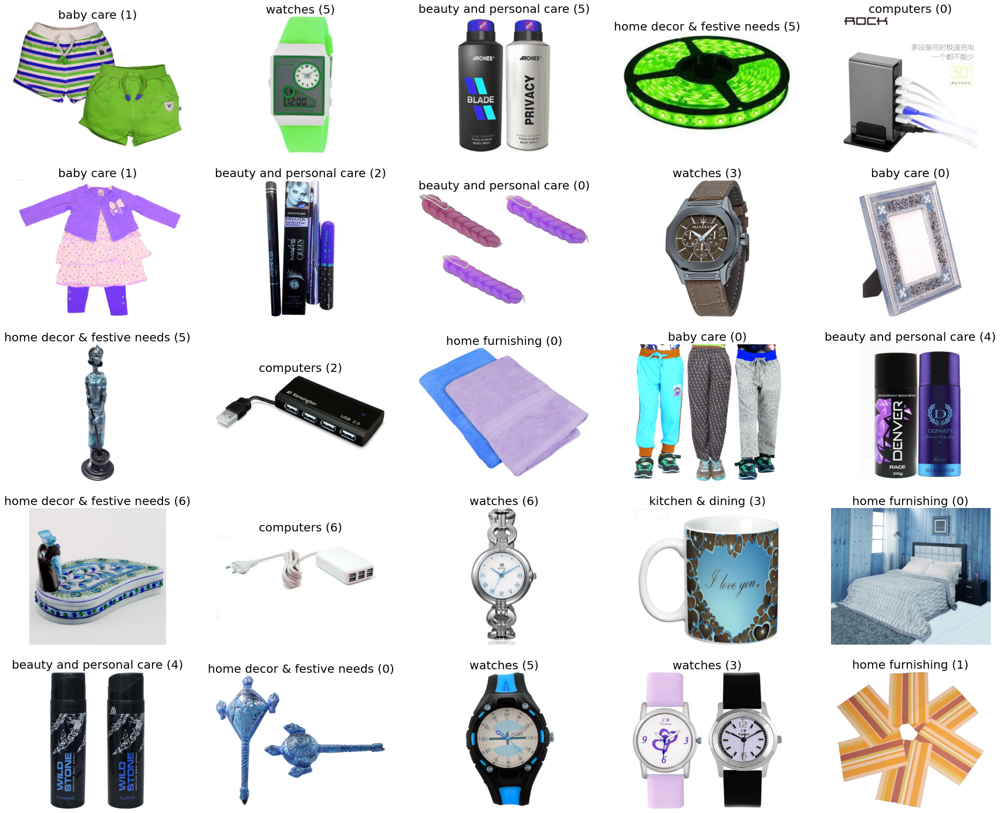

In [12]:
from sklearn.manifold import TSNE

_df, _ari = app.compute_ari(n_components=2, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[SIFT] Clustering des produits par TSNE 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[SIFT] Clustering des produits par TSNE 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

Computing ARI with PCA(2d)...
ARI with PCA(2): 0.0406
Plot clustering...


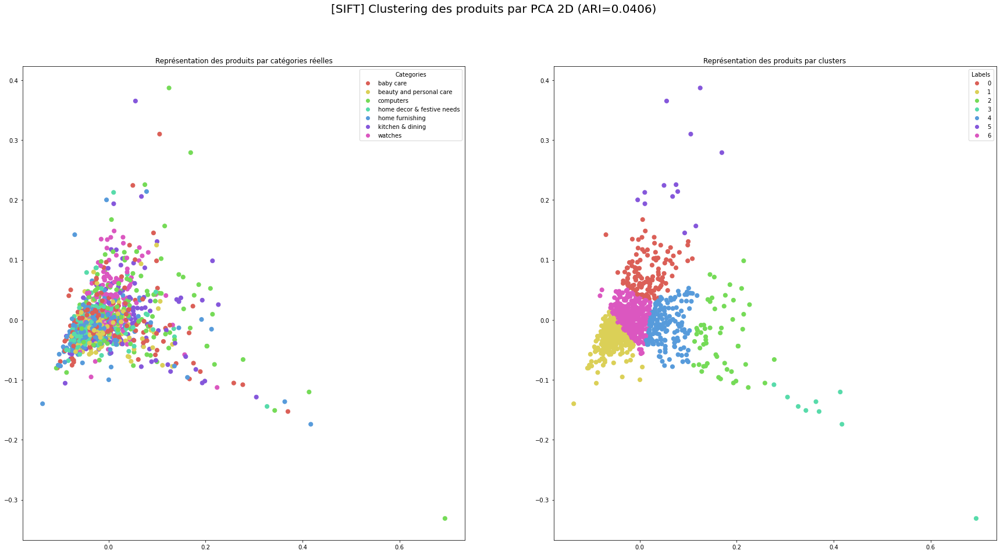

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

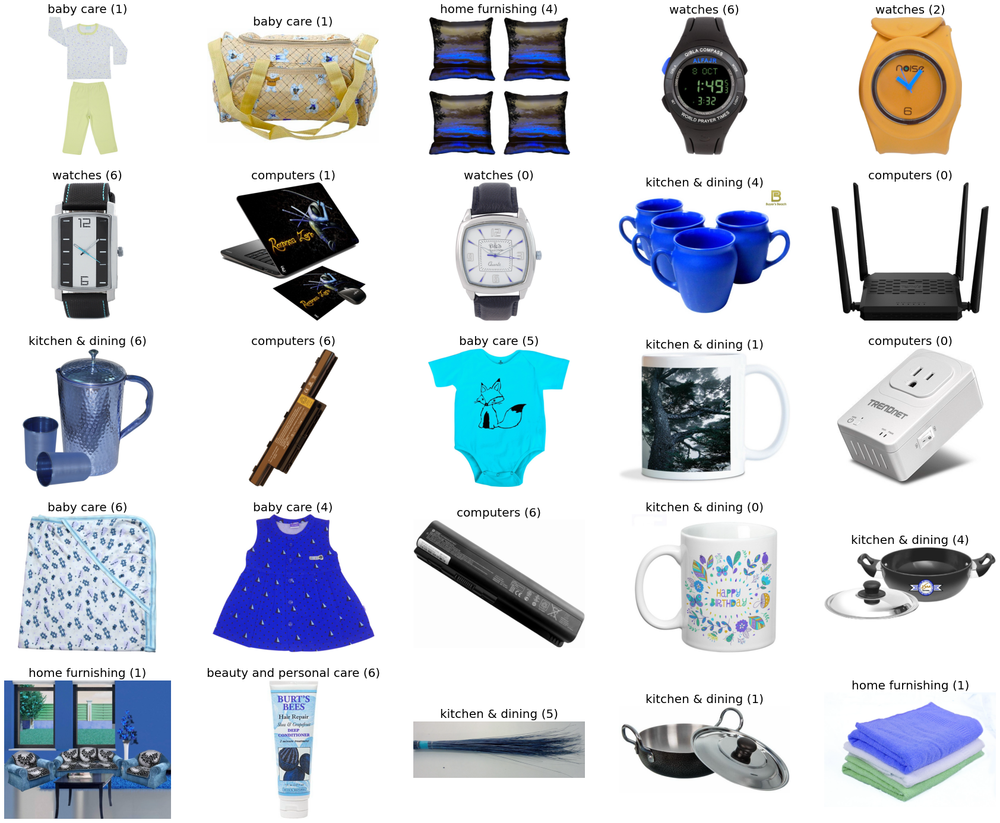

Computing ARI with PCA(3d)...
ARI with PCA(3): 0.0518
Plot clustering...


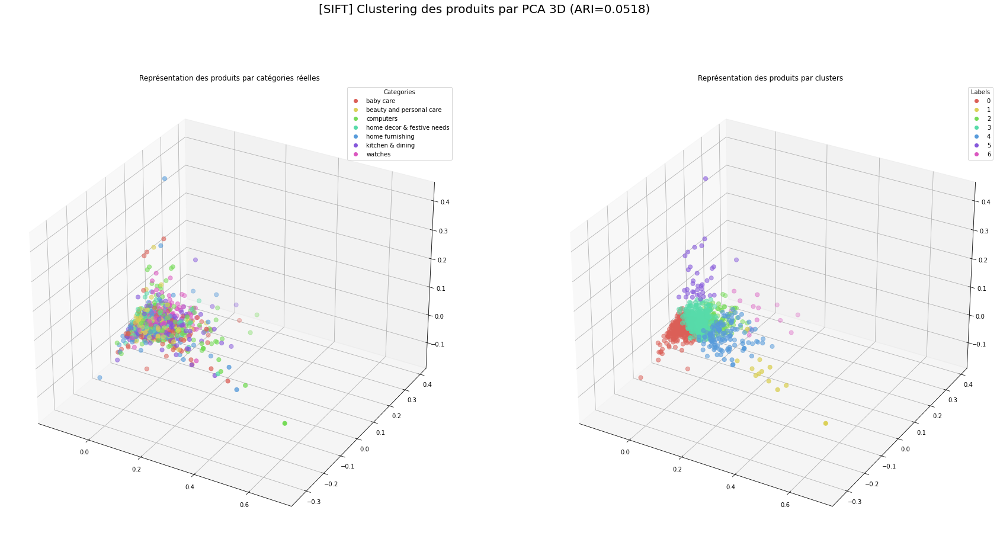

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

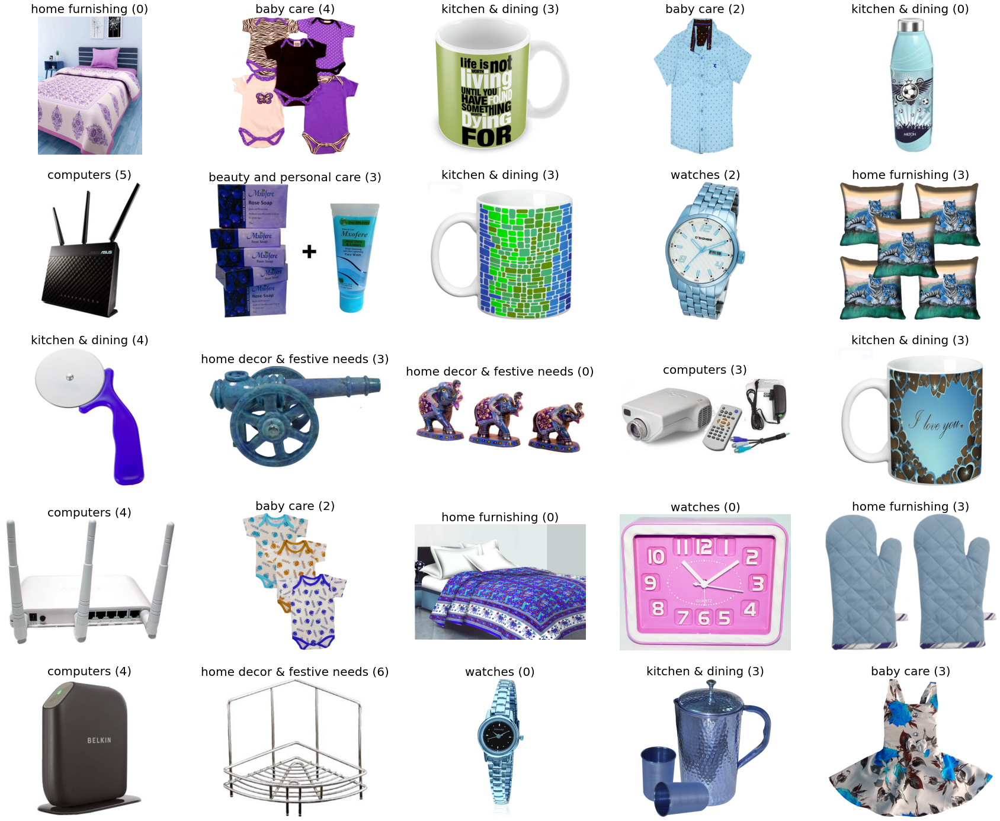

In [13]:
from sklearn.decomposition import PCA

_df, _ari = app.compute_ari(n_components=2, model=PCA)
app.plot_clustering(_df, title=f"[SIFT] Clustering des produits par PCA 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=PCA)
app.plot_clustering(_df, title=f"[SIFT] Clustering des produits par PCA 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

### Clustering des images avec CNN Transfer Learning

#### VGG16

In [14]:
from tensorflow.keras.applications import VGG16
layers = VGG16().layers
for i in (0, -2, -1):
    print("name:", layers[i].name, "- shape:", layers[i].get_output_at(0).get_shape().as_list())

name: input_1 - shape: [None, 224, 224, 3]
name: fc2 - shape: [None, 4096]
name: predictions - shape: [None, 1000]


Loading images...


  0%|          | 0/1050 [00:00<?, ?it/s]

number of images : 1050 , number of class : 7
Create VggWrapper wrapper...


  0%|          | 0/1050 [00:00<?, ?it/s]

Preprocess images...


  0%|          | 0/1050 [00:00<?, ?it/s]

c:\Users\flori\miniconda3\envs\jupyter\lib\site-packages\PIL\Image.py:2918: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


Process features...


  0%|          | 0/1050 [00:00<?, ?it/s]

Computing ARI with TSNE(2d)...
ARI with TSNE(2): 0.4393
Plot clustering...


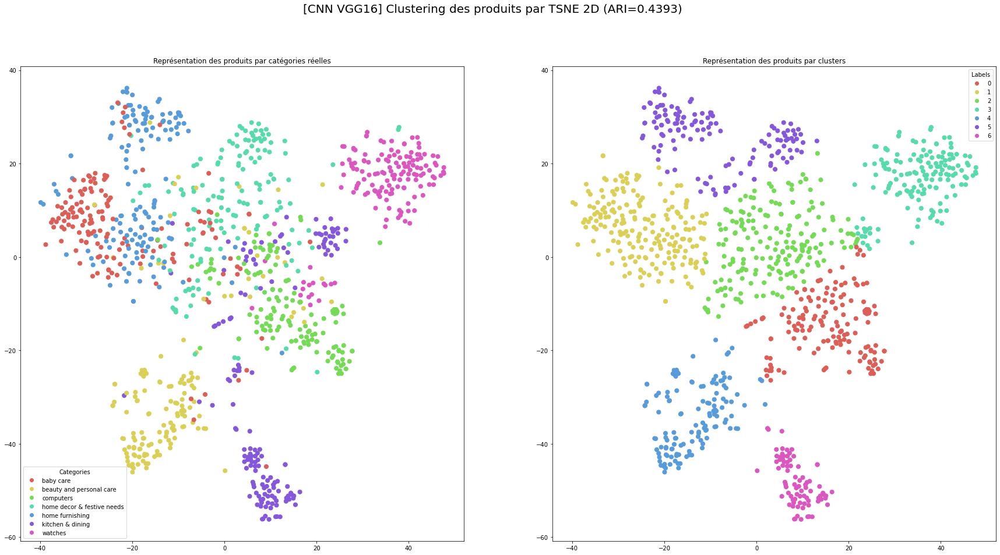

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

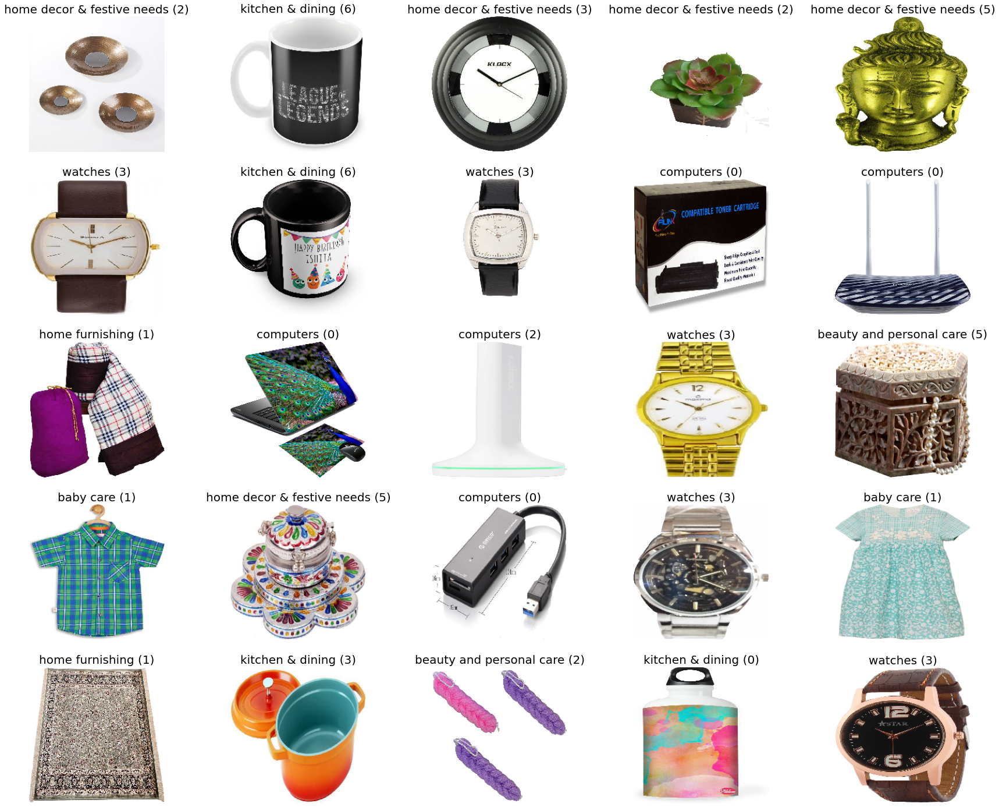

Computing ARI with TSNE(3d)...
ARI with TSNE(3): 0.4543
Plot clustering...


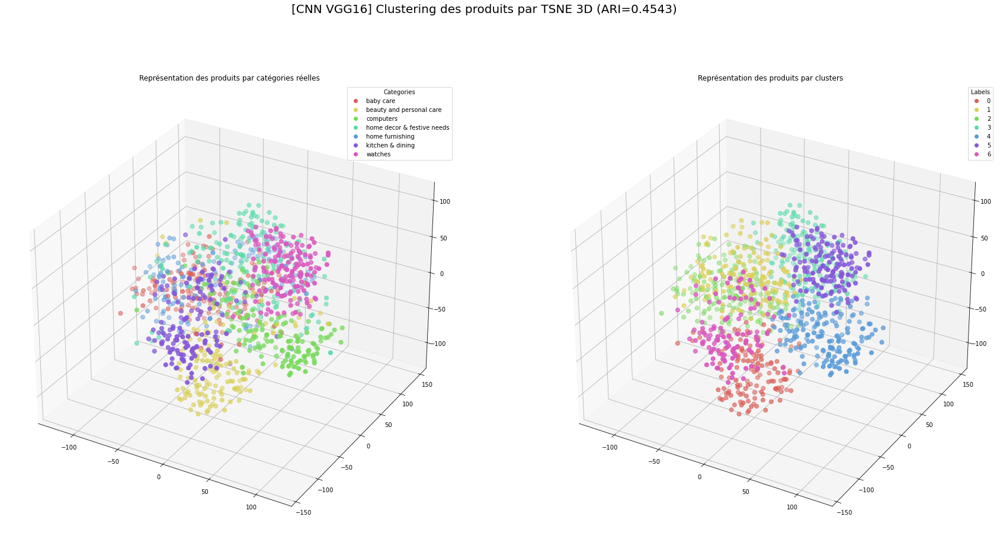

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

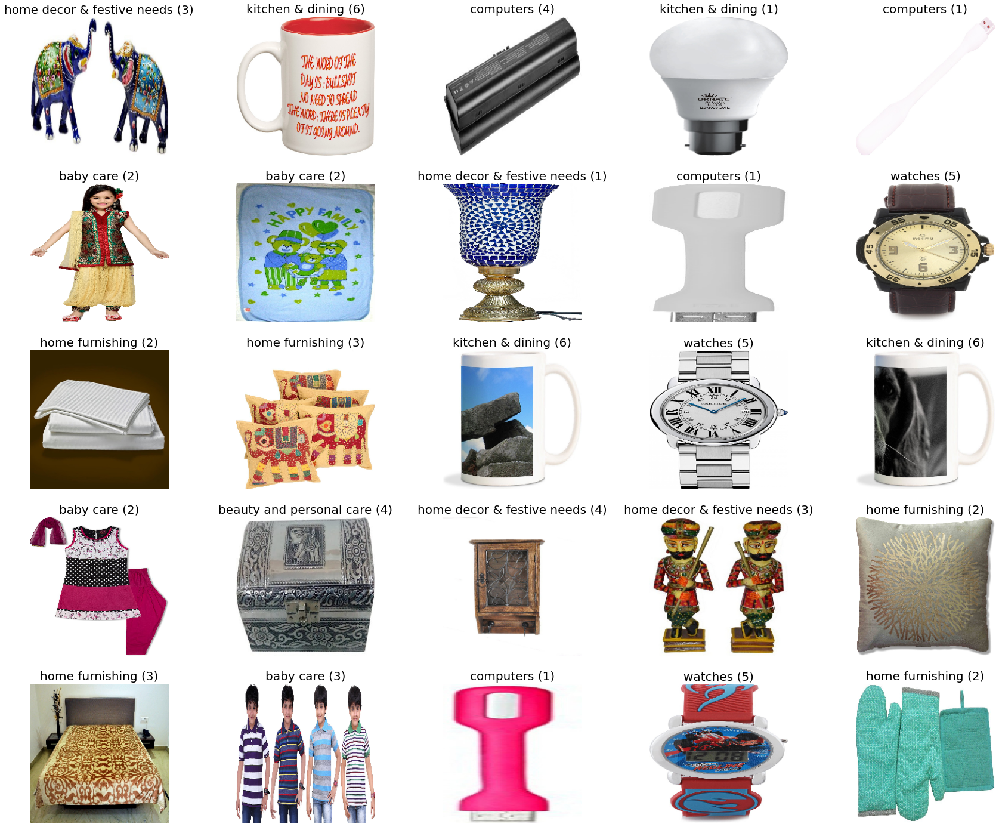

Computing ARI with PCA(2d)...
ARI with PCA(2): 0.2918
Plot clustering...


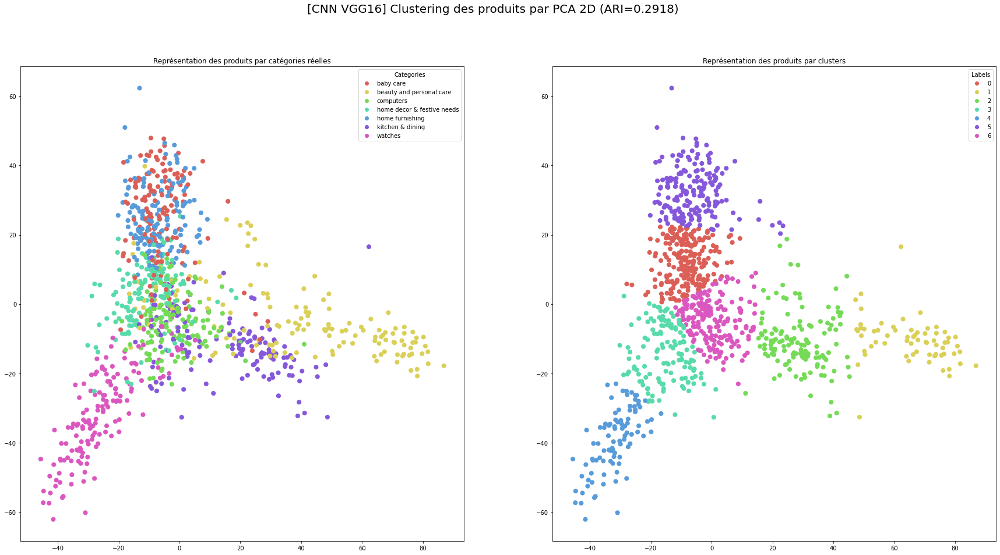

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

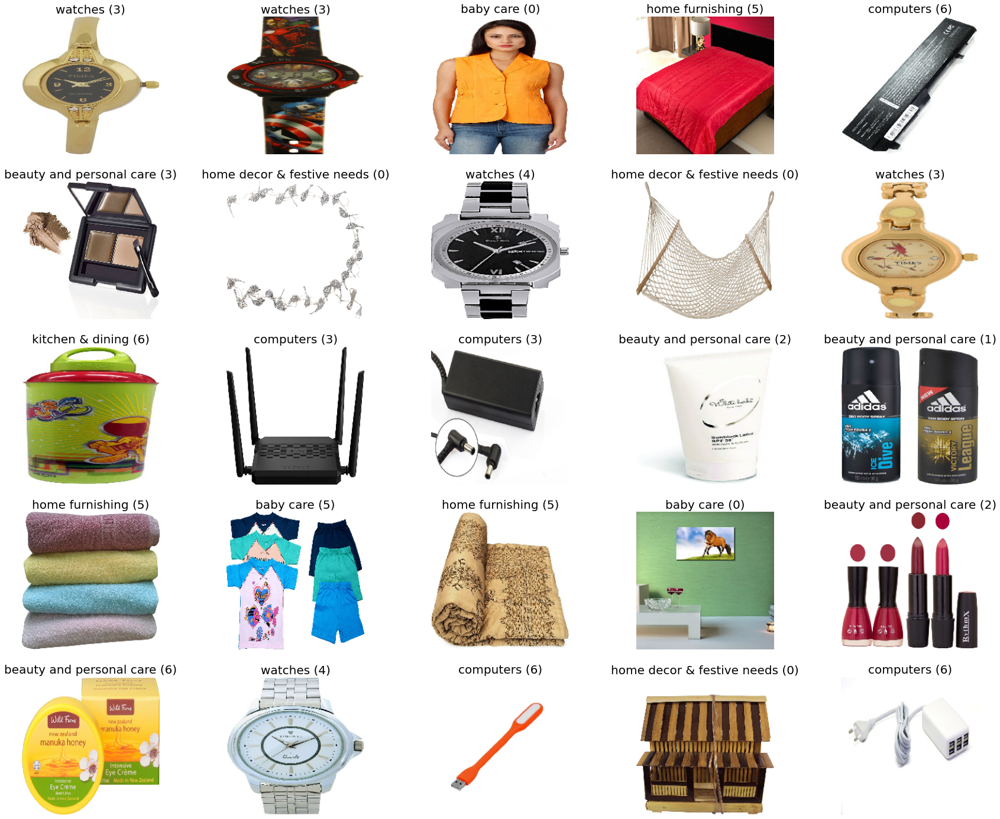

Computing ARI with PCA(3d)...
ARI with PCA(3): 0.4397
Plot clustering...


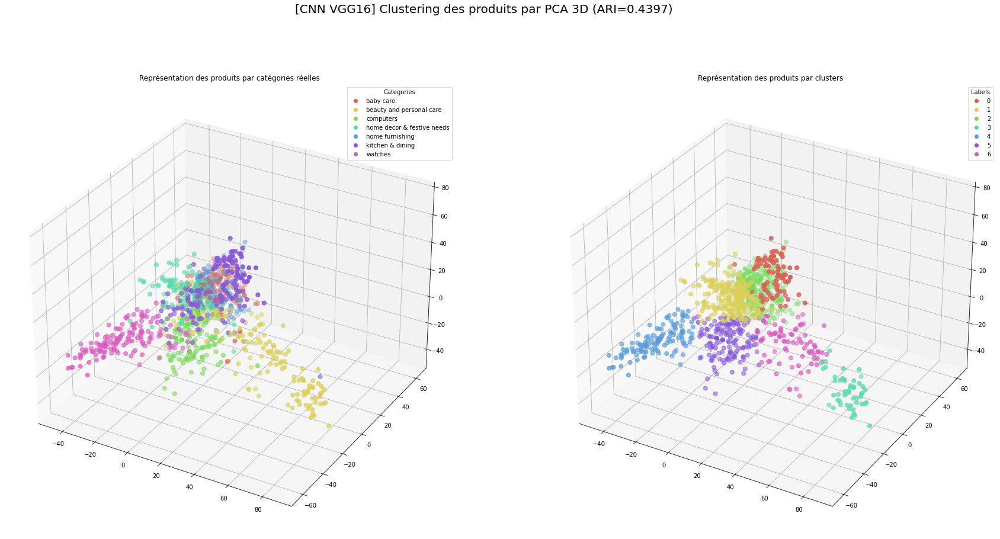

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

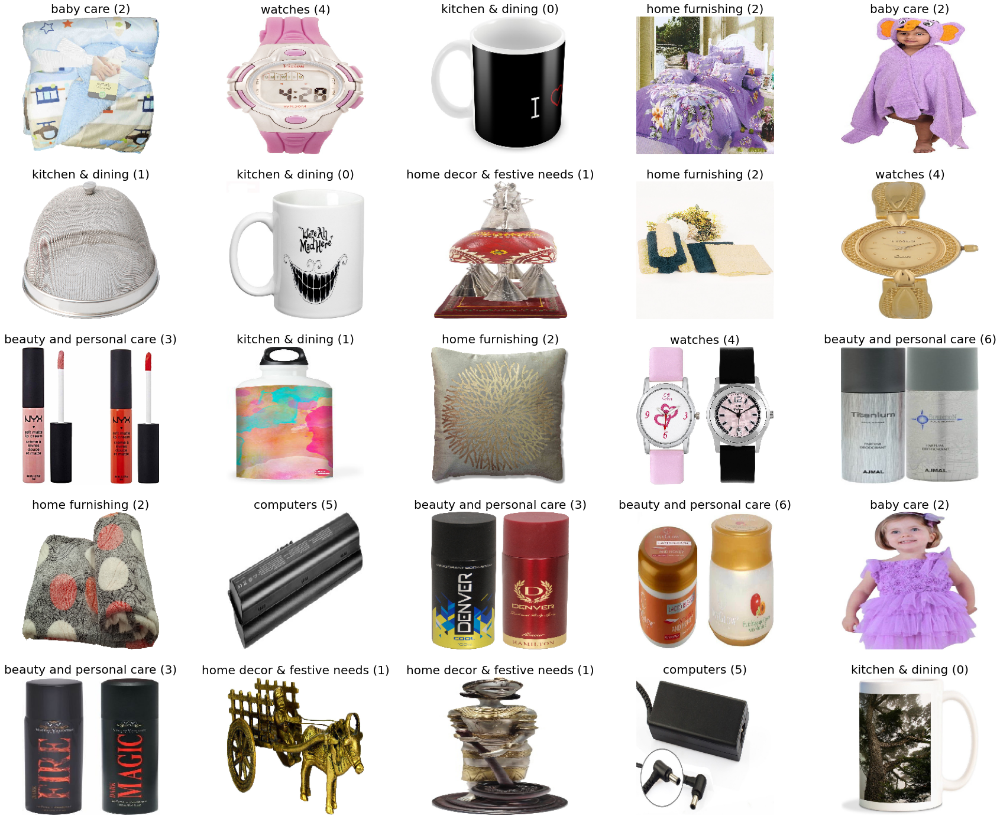

In [15]:
from src.keras_app import KerasApp, VggWrapper
app = KerasApp(sample_data['image'].to_dict(), sample_data['product_category_0'].to_dict(), model_wrapper_class=VggWrapper)
app.preprocess_images(target_size=(224, 224))

app.process_features(force_reload=True)
app.get_model_features().head()

from sklearn.manifold import TSNE

_df, _ari = app.compute_ari(n_components=2, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[CNN VGG16] Clustering des produits par TSNE 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[CNN VGG16] Clustering des produits par TSNE 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

from sklearn.decomposition import PCA

_df, _ari = app.compute_ari(n_components=2, model=PCA)
app.plot_clustering(_df, title=f"[CNN VGG16] Clustering des produits par PCA 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=PCA)
app.plot_clustering(_df, title=f"[CNN VGG16] Clustering des produits par PCA 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

#### Inception V3

In [16]:
from tensorflow.keras.applications import InceptionV3
layers = InceptionV3().layers
for i in (0, -2, -1):
    print("name:", layers[i].name, "- shape:", layers[i].get_output_at(0).get_shape().as_list())

name: input_6 - shape: [None, 299, 299, 3]
name: avg_pool - shape: [None, 2048]
name: predictions - shape: [None, 1000]


Loading images...


  0%|          | 0/1050 [00:00<?, ?it/s]

number of images : 1050 , number of class : 7
Create InceptionWrapper wrapper...


  0%|          | 0/1050 [00:00<?, ?it/s]

Preprocess images...


  0%|          | 0/1050 [00:00<?, ?it/s]

c:\Users\flori\miniconda3\envs\jupyter\lib\site-packages\PIL\Image.py:2918: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


Process features...


  0%|          | 0/1050 [00:00<?, ?it/s]

Computing ARI with TSNE(2d)...
ARI with TSNE(2): 0.0591
Plot clustering...


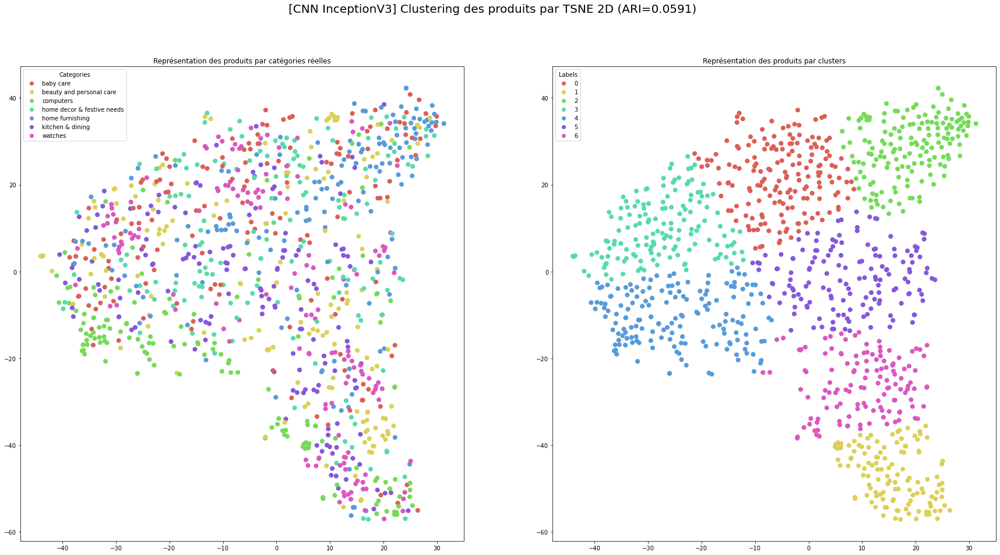

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

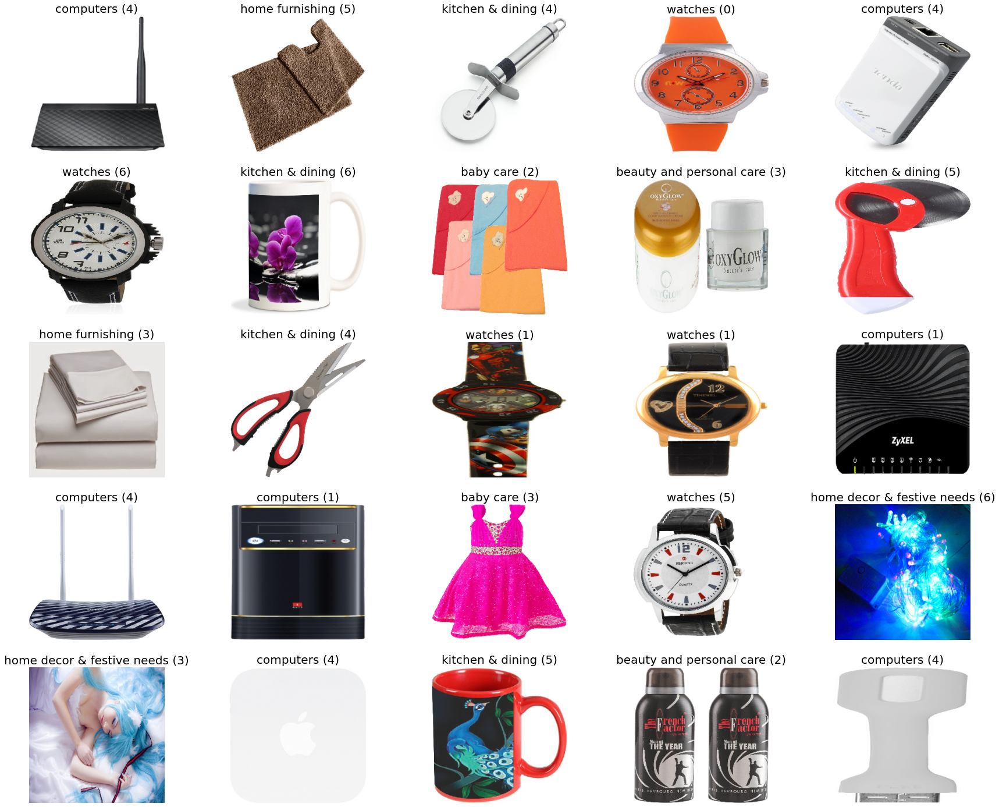

Computing ARI with TSNE(3d)...
ARI with TSNE(3): 0.0557
Plot clustering...


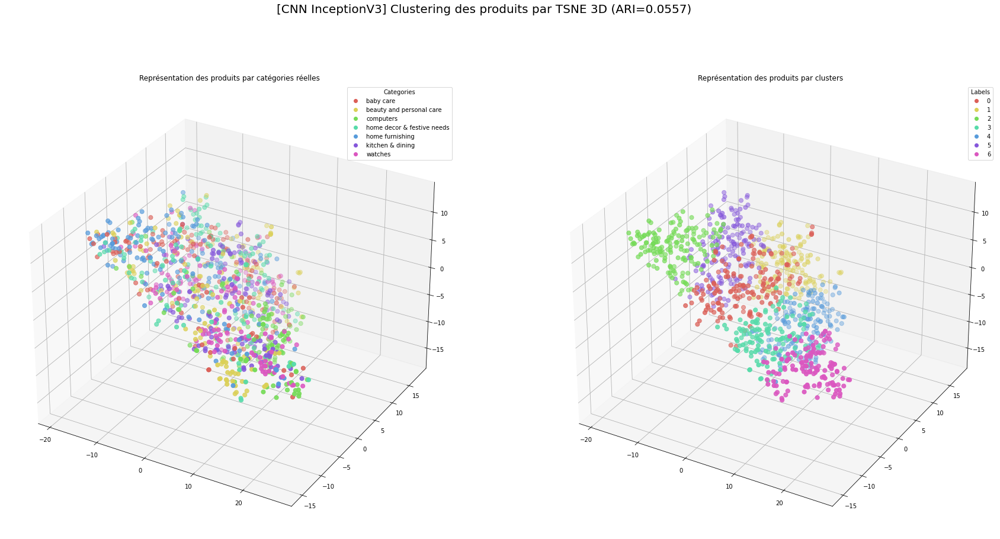

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

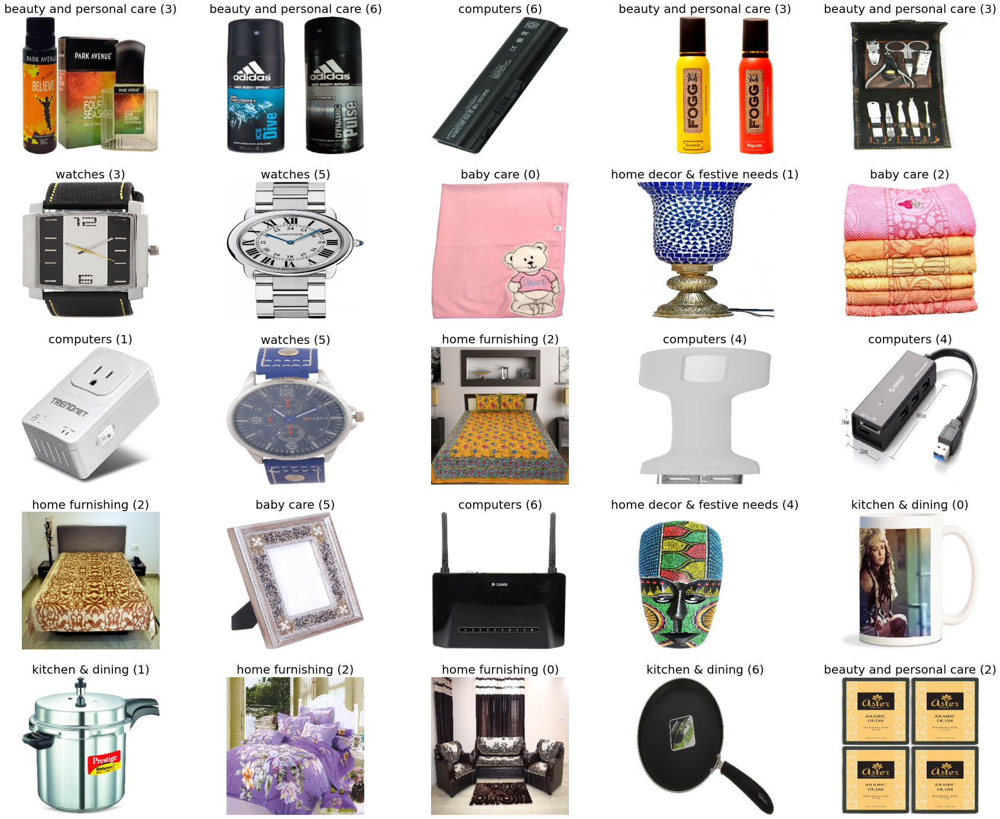

Computing ARI with PCA(2d)...
ARI with PCA(2): 0.0347
Plot clustering...


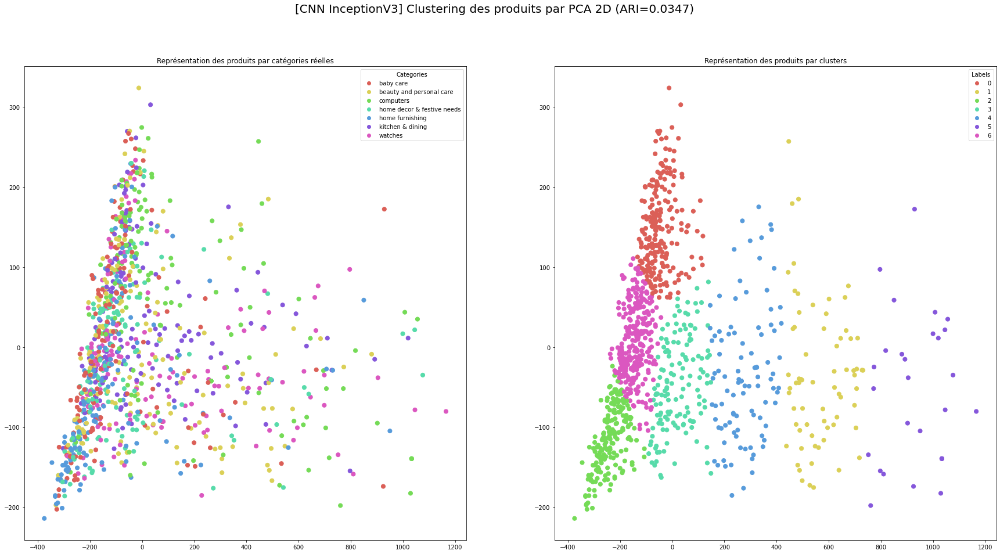

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

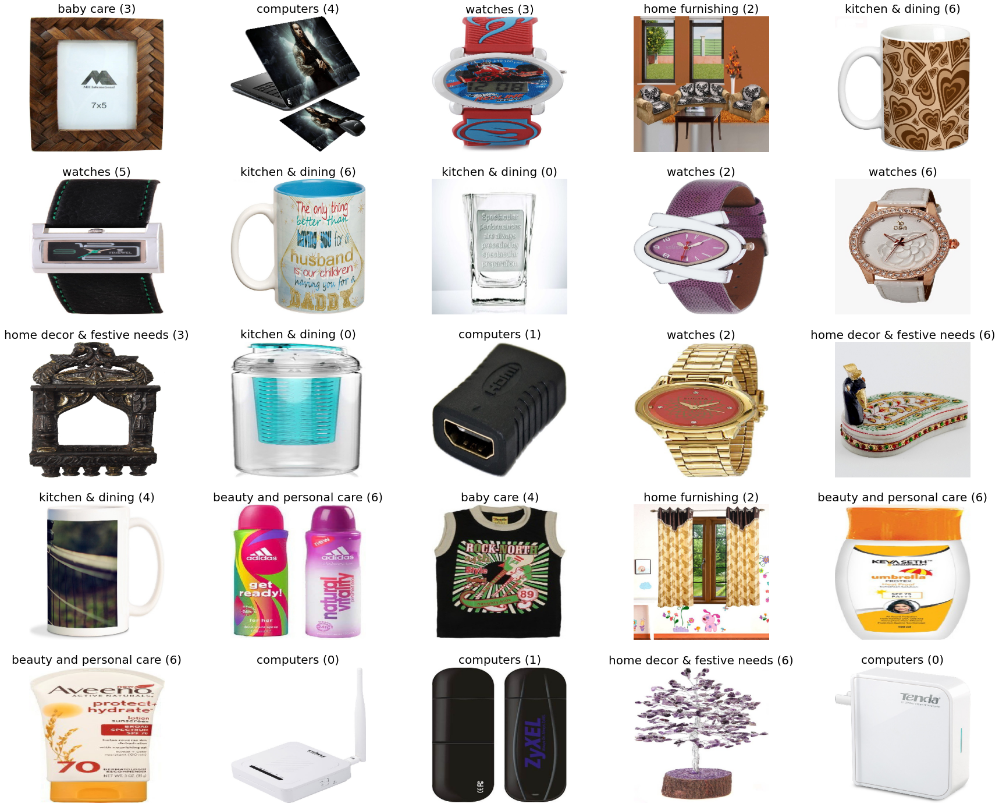

Computing ARI with PCA(3d)...
ARI with PCA(3): 0.0361
Plot clustering...


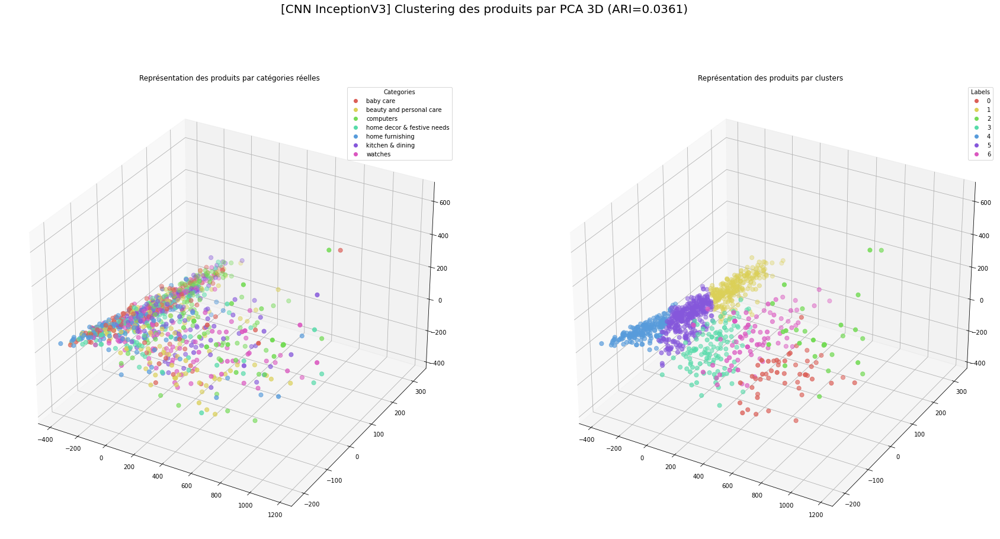

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

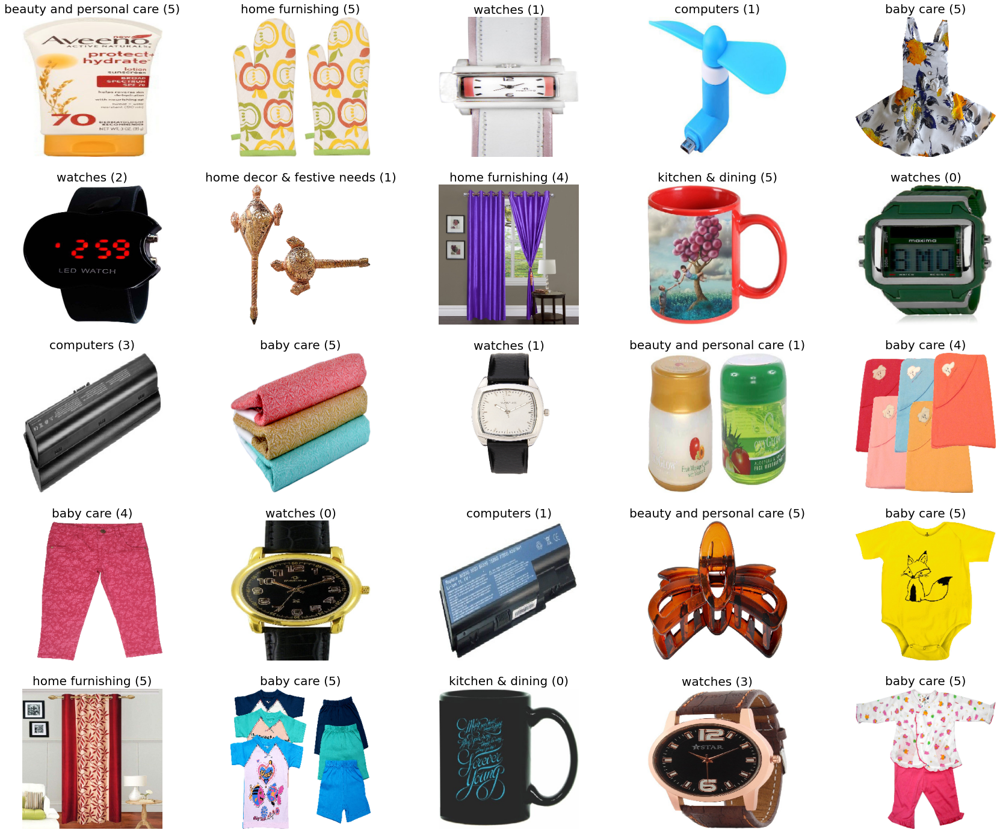

In [17]:
from src.keras_app import KerasApp, InceptionWrapper
app = KerasApp(sample_data['image'].to_dict(), sample_data['product_category_0'].to_dict(), model_wrapper_class=InceptionWrapper)
app.preprocess_images(target_size=(299, 299))

app.process_features(force_reload=True)
app.get_model_features().head()

from sklearn.manifold import TSNE

_df, _ari = app.compute_ari(n_components=2, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[CNN InceptionV3] Clustering des produits par TSNE 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[CNN InceptionV3] Clustering des produits par TSNE 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

from sklearn.decomposition import PCA

_df, _ari = app.compute_ari(n_components=2, model=PCA)
app.plot_clustering(_df, title=f"[CNN InceptionV3] Clustering des produits par PCA 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=PCA)
app.plot_clustering(_df, title=f"[CNN InceptionV3] Clustering des produits par PCA 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

#### ResNet50V2

In [18]:
from tensorflow.keras.applications import ResNet50V2
layers = ResNet50V2().layers
for i in (0, -2, -1):
    print("name:", layers[i].name, "- shape:", layers[i].get_output_at(0).get_shape().as_list())

name: input_7 - shape: [None, 224, 224, 3]
name: avg_pool - shape: [None, 2048]
name: predictions - shape: [None, 1000]


Loading images...


  0%|          | 0/1050 [00:00<?, ?it/s]

number of images : 1050 , number of class : 7
Create ResNetWrapper wrapper...


  0%|          | 0/1050 [00:00<?, ?it/s]

Preprocess images...


  0%|          | 0/1050 [00:00<?, ?it/s]

c:\Users\flori\miniconda3\envs\jupyter\lib\site-packages\PIL\Image.py:2918: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


Process features...


  0%|          | 0/1050 [00:00<?, ?it/s]

Computing ARI with TSNE(2d)...
ARI with TSNE(2): 0.0326
Plot clustering...


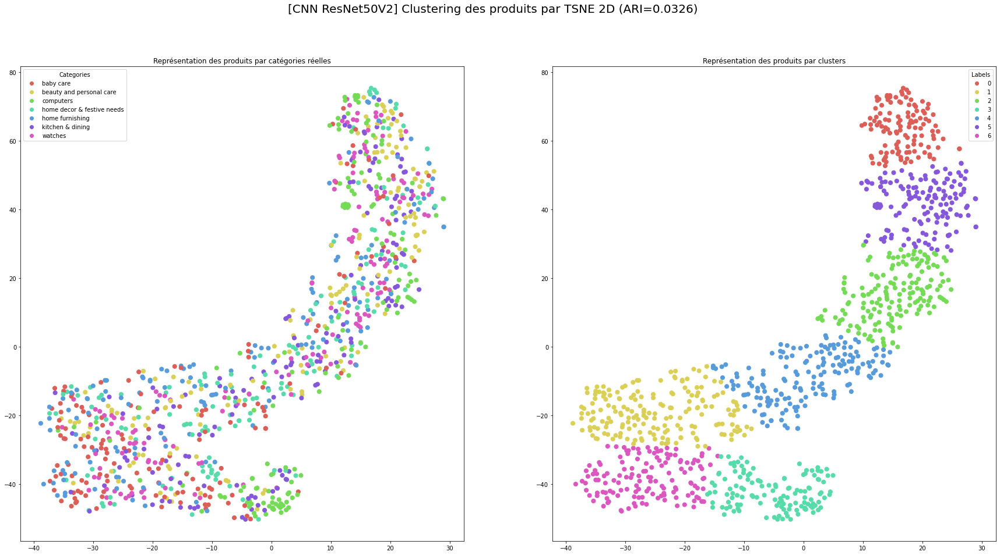

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

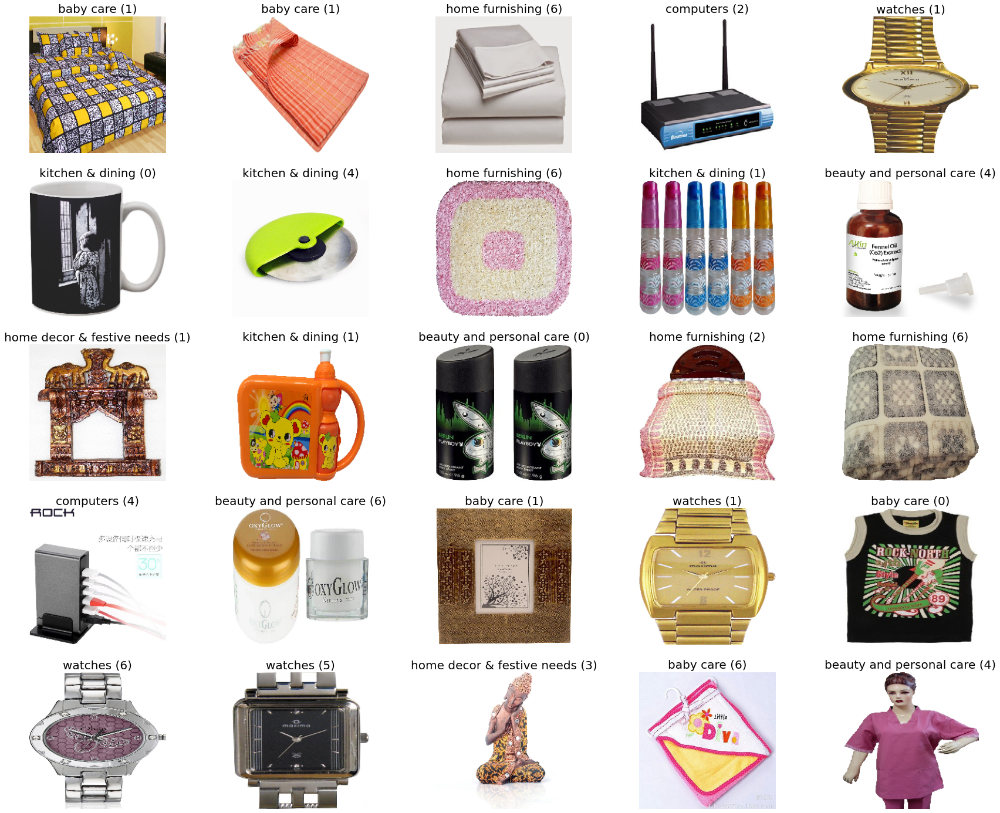

Computing ARI with TSNE(3d)...
ARI with TSNE(3): 0.0307
Plot clustering...


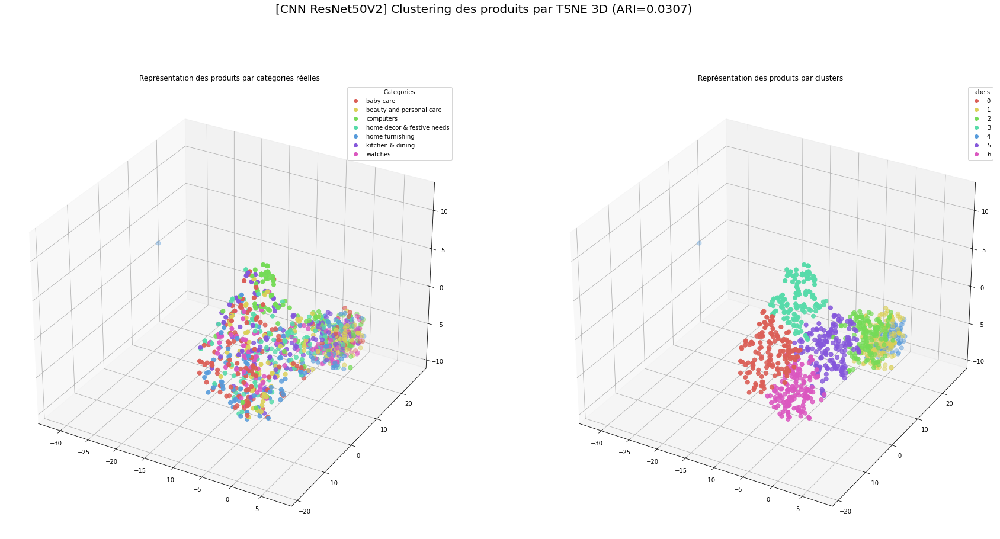

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

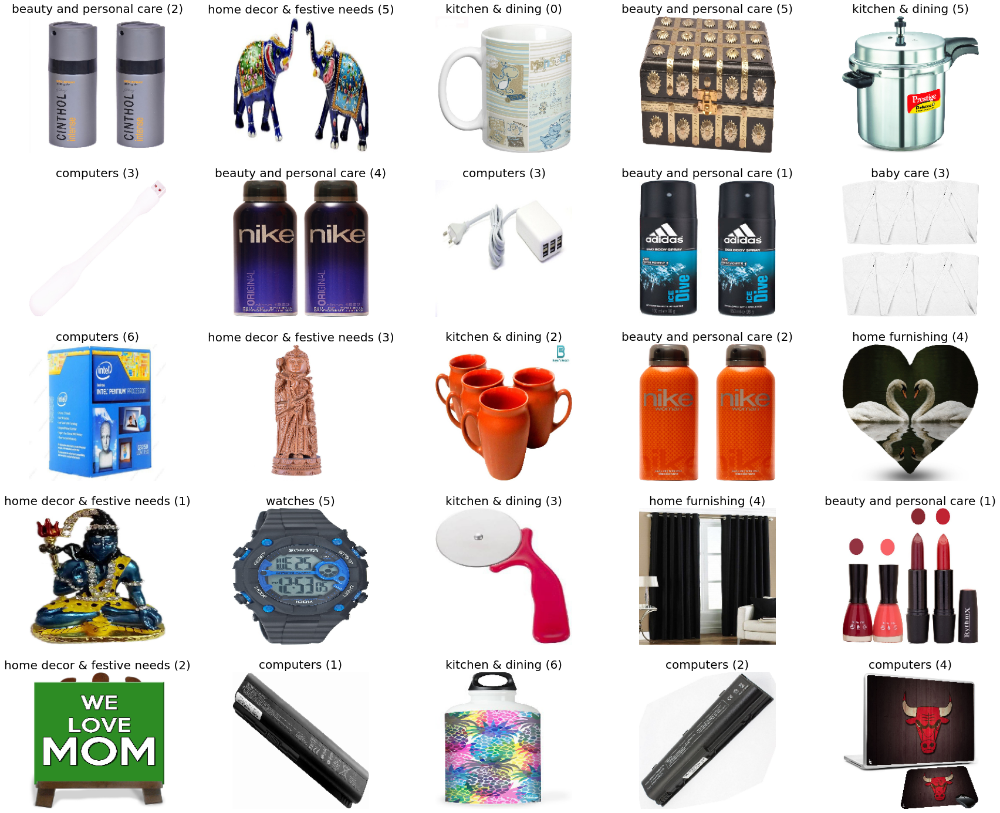

Computing ARI with PCA(2d)...
ARI with PCA(2): 0.0171
Plot clustering...


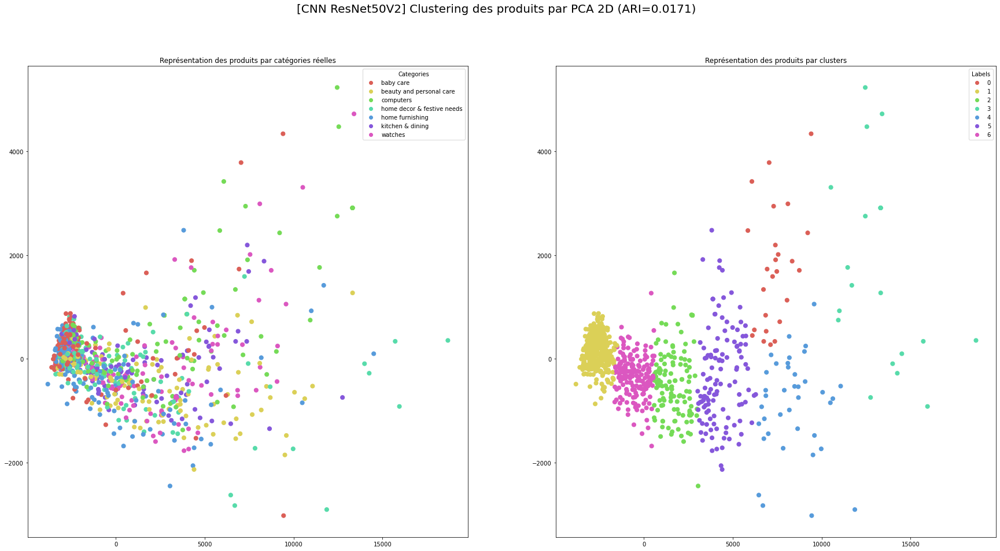

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

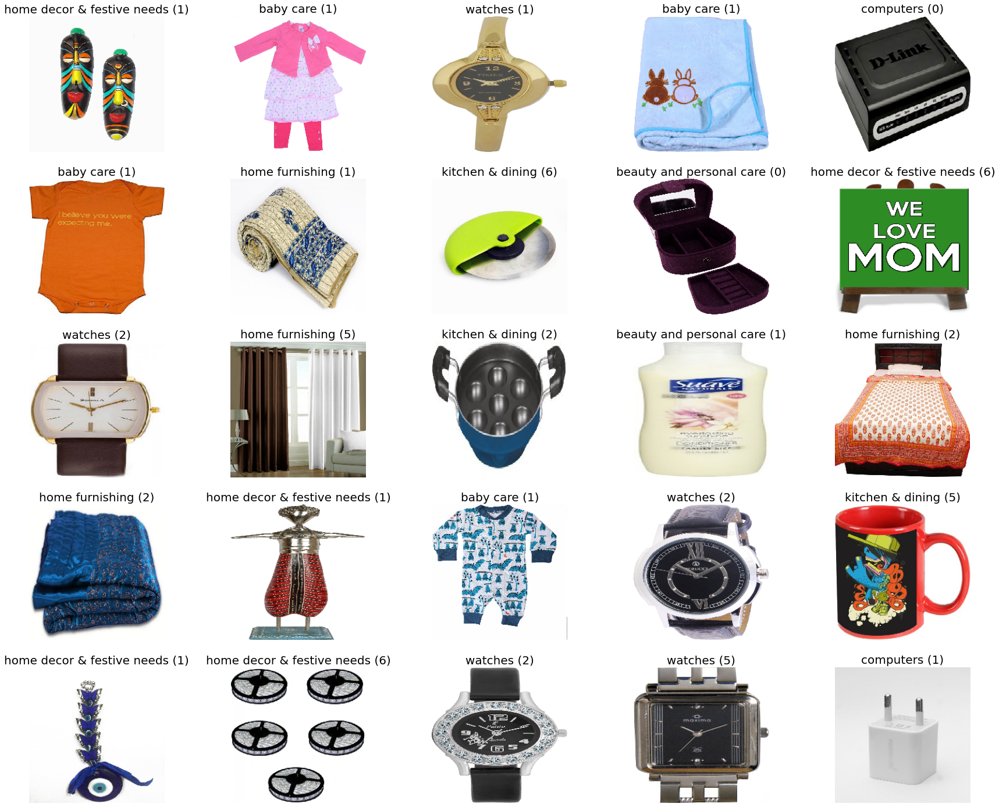

Computing ARI with PCA(3d)...
ARI with PCA(3): 0.0166
Plot clustering...


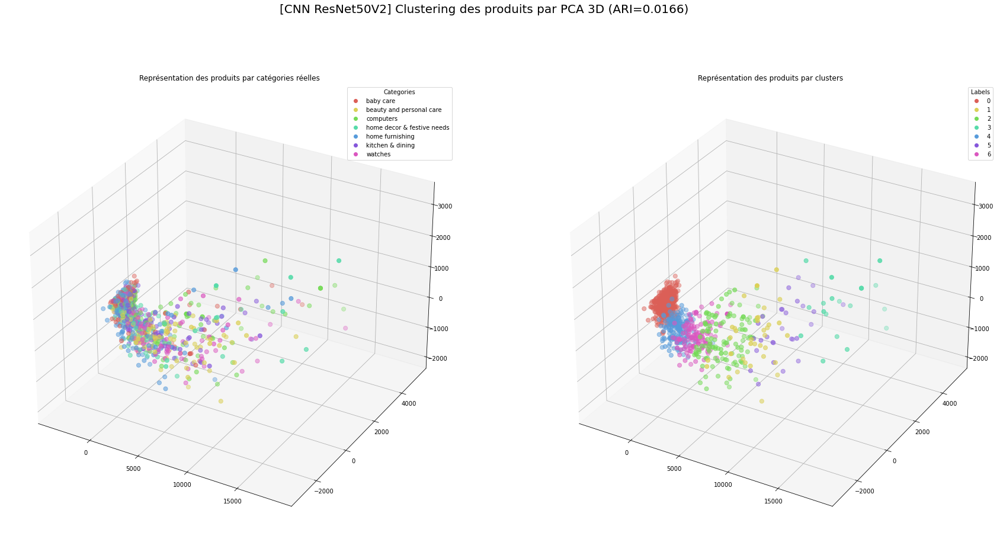

Plot images with categories...


  0%|          | 0/25 [00:00<?, ?it/s]

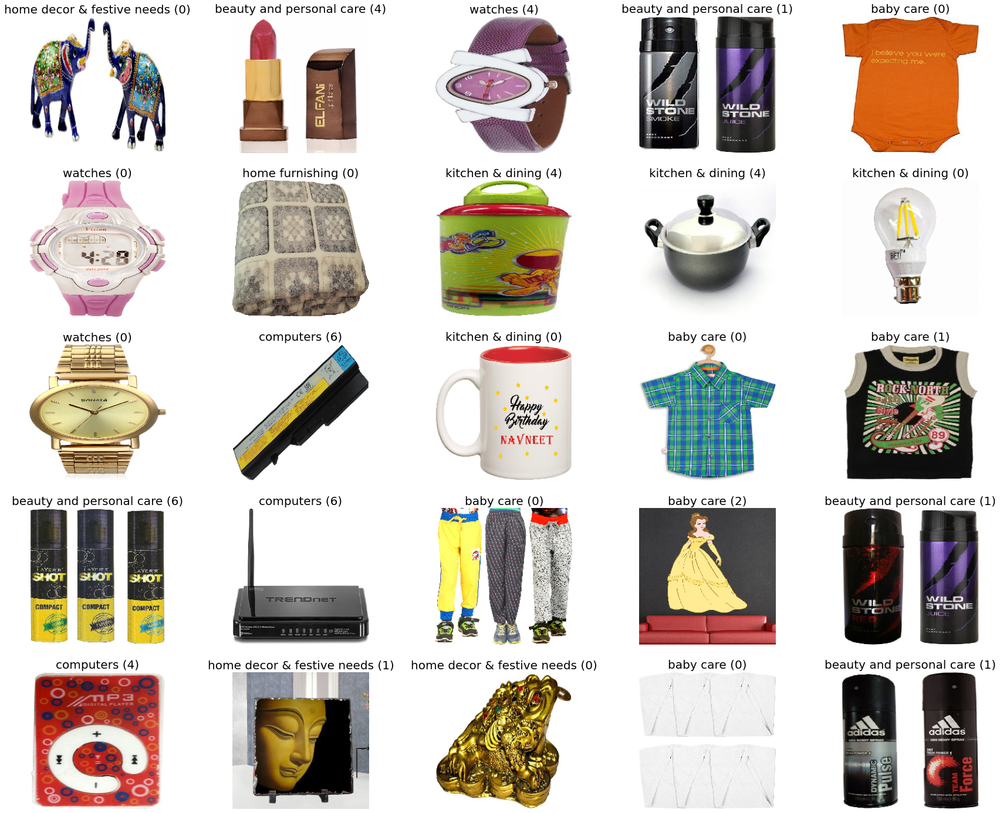

In [19]:
from src.keras_app import KerasApp, ResNetWrapper
app = KerasApp(sample_data['image'].to_dict(), sample_data['product_category_0'].to_dict(), model_wrapper_class=ResNetWrapper)
app.preprocess_images(target_size=(224, 224))

app.process_features(force_reload=True)
app.get_model_features().head()

from sklearn.manifold import TSNE

_df, _ari = app.compute_ari(n_components=2, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[CNN ResNet50V2] Clustering des produits par TSNE 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=TSNE, model_kw={'perplexity': 30, 'n_iter': 2000, 'init': 'random', 'learning_rate': 200, 'random_state': 42})
app.plot_clustering(_df, title=f"[CNN ResNet50V2] Clustering des produits par TSNE 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

from sklearn.decomposition import PCA

_df, _ari = app.compute_ari(n_components=2, model=PCA)
app.plot_clustering(_df, title=f"[CNN ResNet50V2] Clustering des produits par PCA 2D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

_df, _ari = app.compute_ari(n_components=3, model=PCA)
app.plot_clustering(_df, title=f"[CNN ResNet50V2] Clustering des produits par PCA 3D (ARI={_ari:.4f})")
app.plot_images(_df, n_sample=25)

### Export du notebook en HTML

In [21]:
!jupyter nbconvert --config nbconvert/config_html.py

[NbConvertApp] Converting notebook P6_01_notebookexploration.ipynb to html
[NbConvertApp] Writing 787215 bytes to P6_01_notebookexploration.html
[NbConvertApp] Converting notebook P6_02_notebookbagofword.ipynb to html
[NbConvertApp] Writing 3641906 bytes to P6_02_notebookbagofword.html
[NbConvertApp] Converting notebook P6_03_notebookembedding.ipynb to html
[NbConvertApp] Writing 8347677 bytes to P6_03_notebookembedding.html
[NbConvertApp] Converting notebook P6_04_notebookimages.ipynb to html
[NbConvertApp] Writing 48579619 bytes to P6_04_notebookimages.html
